In [1]:
%load_ext autoreload
%autoreload 2

from pathlib import Path

import dotenv
import matplotlib.pyplot as plt
import scanpy as sc
import tensorflow as tf
from keras import callbacks
from keras.models import Model
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import minmax_scale

from isrobust_TFG.bio import get_reactome_adj, sync_gexp_adj
from isrobust_TFG.datasets import load_kang
from isrobust_TFG.utils import set_all_seeds

project_path = Path(dotenv.find_dotenv()).parent
results_path = project_path.joinpath("results")
results_path.mkdir(exist_ok=True, parents=True)
data_path = project_path.joinpath("data")
data_path.mkdir(exist_ok=True, parents=True)
figs_path = results_path.joinpath("figs")
figs_path.mkdir(exist_ok=True, parents=True)
tables_path = results_path.joinpath("tables")
tables_path.mkdir(exist_ok=True, parents=True)

set_all_seeds(seed=42)

tf.config.experimental.enable_op_determinism()

sc.set_figure_params(dpi=300, color_map="inferno")
sc.settings.verbosity = 1
sc.logging.print_header()

2024-12-26 18:35:56.176969: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.8 anndata==0.10.9 umap==0.5.6 numpy==1.26.4 scipy==1.10.1 pandas==2.2.3 scikit-learn==1.5.2 statsmodels==0.14.4 igraph==0.10.8 pynndescent==0.5.13


In [2]:
adata = load_kang(data_folder=data_path, normalize=True, n_genes=4000)

/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/aesteban/TFM/robustness_informed_TFM/isrobust_TFM/datasets.py:18: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs["label"] = adata.obs["label"].replace(


In [3]:
x_trans = adata.to_df()

In [4]:
reactome = get_reactome_adj()

reactome.head()

geneset,REACTOME_2_LTR_CIRCLE_FORMATION,REACTOME_ABACAVIR_METABOLISM,REACTOME_ABACAVIR_TRANSMEMBRANE_TRANSPORT,REACTOME_ABACAVIR_TRANSPORT_AND_METABOLISM,REACTOME_ABC_FAMILY_PROTEINS_MEDIATED_TRANSPORT,REACTOME_ABC_TRANSPORTERS_IN_LIPID_HOMEOSTASIS,REACTOME_ABC_TRANSPORTER_DISORDERS,REACTOME_ABERRANT_REGULATION_OF_MITOTIC_EXIT_IN_CANCER_DUE_TO_RB1_DEFECTS,REACTOME_ABERRANT_REGULATION_OF_MITOTIC_G1_S_TRANSITION_IN_CANCER_DUE_TO_RB1_DEFECTS,REACTOME_ABORTIVE_ELONGATION_OF_HIV_1_TRANSCRIPT_IN_THE_ABSENCE_OF_TAT,...,REACTOME_WNT5A_DEPENDENT_INTERNALIZATION_OF_FZD2_FZD5_AND_ROR2,REACTOME_WNT5A_DEPENDENT_INTERNALIZATION_OF_FZD4,REACTOME_WNT_LIGAND_BIOGENESIS_AND_TRAFFICKING,REACTOME_WNT_MEDIATED_ACTIVATION_OF_DVL,REACTOME_XENOBIOTICS,REACTOME_YAP1_AND_WWTR1_TAZ_STIMULATED_GENE_EXPRESSION,REACTOME_ZBP1_DAI_MEDIATED_INDUCTION_OF_TYPE_I_IFNS,REACTOME_ZINC_EFFLUX_AND_COMPARTMENTALIZATION_BY_THE_SLC30_FAMILY,REACTOME_ZINC_INFLUX_INTO_CELLS_BY_THE_SLC39_GENE_FAMILY,REACTOME_ZINC_TRANSPORTERS
genesymbol,,,,,,,,,,,,,,,,,,,,,
A1BG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A1CF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A2M,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A4GNT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAAS,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
x_trans, reactome = sync_gexp_adj(x_trans, reactome)

In [6]:
x_trans.shape, reactome.shape

((24673, 2160), (2160, 1615))

In [7]:
obs = adata.obs.copy()

x_train, x_test = train_test_split(
    x_trans.apply(minmax_scale),
    test_size=0.33,
    stratify=obs["cell_type"],
    random_state=42,
)
x_train = x_train.astype("float32")
x_test = x_test.astype("float32")

In [8]:
x_train.shape, reactome.shape

((16530, 2160), (2160, 1615))

In [9]:
from isrobust_TFG.CI_VAE_CLASS import InformedVAE

In [10]:
model = InformedVAE(
    adjacency_matrices=reactome, adjacency_names="reactome", adjacency_activation="tanh"
)

model._build_vae()

batch_size = 32

callback = callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=1e-1,
    patience=100,
    verbose=0,
)

history = model.fit(
    x_train,
    x_train,
    shuffle=True,
    verbose=1,
    epochs=100,
    batch_size=batch_size,
    callbacks=[callback],
    validation_data=(x_test, x_test),
)

Model: "vae_mlp"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 2160)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ encoder             │ [(None, 807),     │  6,098,239 │ input_layer[0][0] │
│ (Functional)        │ (None, 807),      │            │                   │
│                     │ (None, 807)]      │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reactome (Dense)    │ (None, 1615)      │  3,490,015 │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ decoder             │ (None, 2160)      │  4,795,480 │ encoder[0][2]     │
│ (Functional)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 807)       │  1,304,112 │ reactome[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 807)       │  1,304,112 │ reactome[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ vae_loss (VAELoss)  │ (None, 2160)      │          0 │ input_layer[0][0… │
│                     │                   │            │ decoder[0][0],    │
│                     │                   │            │ dense[0][0],      │
│                     │                   │            │ dense_1[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 10,893,719 (41.56 MB)

 Trainable params: 10,893,719 (41.56 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 23s 41ms/step - loss: 24.0791 - mse: 0.0111 - val_loss: 19.3501 - val_mse: 0.0088
Epoch 2/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 21s 41ms/step - loss: 18.6099 - mse: 0.0085 - val_loss: 16.8375 - val_mse: 0.0077
Epoch 3/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 21s 41ms/step - loss: 16.3758 - mse: 0.0075 - val_loss: 15.1081 - val_mse: 0.0069
Epoch 4/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 21s 41ms/step - loss: 14.7158 - mse: 0.0067 - val_loss: 13.6397 - val_mse: 0.0062
Epoch 5/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 21s 41ms/step - loss: 13.3415 - mse: 0.0061 - val_loss: 12.4681 - val_mse: 0.0057
Epoch 6/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 21s 41ms/step - loss: 12.2303 - mse: 0.0055 - val_loss: 11.6037 - val_mse: 0.0053
Epoch 7/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 21s 41ms/step - loss: 11.4174 - mse: 0.0052 - val_loss: 10.9291 - val_mse: 0.0050
Epoch 8/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 21s 41ms/step - loss: 10.7826 - mse: 0.0049 - val_loss: 10.3800 - val_mse: 0.0047
Epoch 9/100
517/

In [13]:
encoder = model.encoder
decoder = model.decoder

In [14]:
import pandas as pd

x_train_encoded = encoder.predict(x_train, batch_size=batch_size)[0]
x_train_encoded = pd.DataFrame(x_train_encoded, index=x_train.index)

adata = sc.AnnData(X=x_train_encoded)
adata.obs = obs.loc[x_train.index]

# sc.pp.log1p(adata)
sc.pp.neighbors(adata, use_rep="X", random_state=42)
sc.tl.leiden(adata, random_state=42)
sc.tl.umap(adata, random_state=42)

517/517 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [15]:
layer_outputs = [layer.output for layer in encoder.layers]
activation_model = Model(inputs=encoder.input, outputs=layer_outputs)

In [16]:
# circuit activity extracted from first layer
layer_id = 1

entitie_names = reactome.columns.str.replace("REACTOME_", "").str.replace("_", " ")
# circuit_names = circuit_to_pathway_adj.rename(columns=pathway_renamer).columns

x_train_encoded = activation_model.predict(x_train, batch_size=batch_size)[layer_id]
x_train_encoded = pd.DataFrame(
    x_train_encoded, index=x_train.index, columns=entitie_names
)

entities_adata = sc.AnnData(X=x_train_encoded.abs())
entities_adata.obs = obs.loc[x_train.index]

# sc.pp.log1p(adata)
sc.pp.neighbors(entities_adata, use_rep="X", random_state=42)
sc.tl.leiden(entities_adata, random_state=42)
sc.tl.umap(entities_adata, random_state=42)

517/517 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step


In [17]:
method = "wilcoxon"
sc.tl.rank_genes_groups(
    entities_adata, "condition", refrence="control", key_added=method, method=method
)

result = entities_adata.uns[method]
groups = ["stimulated"]
dacs = pd.DataFrame(
    {
        group + "_" + key: result[key][group]
        for group in groups
        for key in ["names", "scores", "pvals", "pvals_adj", "logfoldchanges"]
    }
)

dacs.head(10)

/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


,stimulated_names,stimulated_scores,stimulated_pvals,stimulated_pvals_adj,stimulated_logfoldchanges
0,INTERFERON ALPHA BETA SIGNALING,109.116302,0.0,0.0,3.599915
1,INTERFERON SIGNALING,108.598129,0.0,0.0,3.260067
2,ANTIVIRAL MECHANISM BY IFN STIMULATED GENES,103.176956,0.0,0.0,3.396488
3,TERMINATION OF TRANSLESION DNA SYNTHESIS,98.554230,0.0,0.0,1.953014
4,DNA DAMAGE BYPASS,97.890785,0.0,0.0,2.006351
5,NS1 MEDIATED EFFECTS ON HOST PATHWAYS,97.034851,0.0,0.0,1.965336
6,POST TRANSLATIONAL MODIFICATION SYNTHESIS OF G...,89.254562,0.0,0.0,2.447923
7,DDX58 IFIH1 MEDIATED INDUCTION OF INTERFERON A...,88.943481,0.0,0.0,1.996075
8,CYTOKINE SIGNALING IN IMMUNE SYSTEM,88.579857,0.0,0.0,2.553760
9,OAS ANTIVIRAL RESPONSE,84.486969,0.0,0.0,2.201385


In [18]:
dacs_to_write = dacs.head(10).copy()
dacs_to_write.columns = dacs_to_write.columns.str.replace("stimulated_", "")
dacs_to_write = dacs_to_write.rename(columns={"names": "pathways"})
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.title()
dacs_to_write = dacs_to_write.drop("pvals", axis=1)
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace(
    "Alpha Beta", r"$\alpha, \beta$"
)
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ifn", "IFN")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Dna", "DNA")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Oas", "OAS")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ddx58", "DDX58")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ns1", "NS1")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ifih1", "IFIH1 ")
long_name_query = dacs_to_write["pathways"].str.contains(
    "Post Translational Modification Synthesis Of G", case=False
)
dacs_to_write["pathways"].loc[long_name_query] = "Post Translational Modification..."
dacs_to_write.to_latex(
    tables_path.joinpath("ivae_scorer_reactome.tex"),
    float_format="%.2f",
    index=False,
    escape=True,
)

/tmp/ipykernel_212976/2585415073.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dacs_to_write["pathways"].loc[long_name_query] = "Post Translational Modification..."


In [19]:
dacs_to_write

,pathways,scores,pvals_adj,logfoldchanges
0,"Interferon $\alpha, \beta$ Signaling",109.116302,0.0,3.599915
1,Interferon Signaling,108.598129,0.0,3.260067
2,Antiviral Mechanism By IFN Stimulated Genes,103.176956,0.0,3.396488
3,Termination Of Translesion DNA Synthesis,98.554230,0.0,1.953014
4,DNA Damage Bypass,97.890785,0.0,2.006351
5,NS1 Mediated Effects On Host Pathways,97.034851,0.0,1.965336
6,Post Translational Modification...,89.254562,0.0,2.447923
7,DDX58 IFIH1 Mediated Induction Of Interferon ...,88.943481,0.0,1.996075
8,Cytokine Signaling In Immune System,88.579857,0.0,2.553760
9,OAS Antiviral Response,84.486969,0.0,2.201385


In [20]:
dacs_to_write

,pathways,scores,pvals_adj,logfoldchanges
0,"Interferon $\alpha, \beta$ Signaling",109.116302,0.0,3.599915
1,Interferon Signaling,108.598129,0.0,3.260067
2,Antiviral Mechanism By IFN Stimulated Genes,103.176956,0.0,3.396488
3,Termination Of Translesion DNA Synthesis,98.554230,0.0,1.953014
4,DNA Damage Bypass,97.890785,0.0,2.006351
5,NS1 Mediated Effects On Host Pathways,97.034851,0.0,1.965336
6,Post Translational Modification...,89.254562,0.0,2.447923
7,DDX58 IFIH1 Mediated Induction Of Interferon ...,88.943481,0.0,1.996075
8,Cytokine Signaling In Immune System,88.579857,0.0,2.553760
9,OAS Antiviral Response,84.486969,0.0,2.201385


In [22]:
dacs_top = dacs["stimulated_names"][:10]
# dacs_top = dacs_top[dacs_top.str.contains("interferon|ifn", case=False)]
dacs_top

0                      INTERFERON ALPHA BETA SIGNALING
1                                 INTERFERON SIGNALING
2          ANTIVIRAL MECHANISM BY IFN STIMULATED GENES
3             TERMINATION OF TRANSLESION DNA SYNTHESIS
4                                    DNA DAMAGE BYPASS
5                NS1 MEDIATED EFFECTS ON HOST PATHWAYS
6    POST TRANSLATIONAL MODIFICATION SYNTHESIS OF G...
7    DDX58 IFIH1 MEDIATED INDUCTION OF INTERFERON A...
8                  CYTOKINE SIGNALING IN IMMUNE SYSTEM
9                               OAS ANTIVIRAL RESPONSE
Name: stimulated_names, dtype: object

In [23]:
adata.obsm["pathways"] = x_train_encoded.abs()
adata.obs[dacs_to_write.pathways] = adata.obsm["pathways"][dacs_top]

In [26]:
sc.pl.umap(
    adata,
    color=["condition", "cell_type"] + dacs_to_write.pathways.tolist(),
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome_ifn_top10.pdf"), bbox_inches="tight"
)
plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome_ifn_top10.png"),
    bbox_inches="tight",
    dpi=300,
)

/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the 

In [40]:
adata.obs.rename(
    columns={"condition": "Estado", "cell_type": "Tipo de célula"}, inplace=True
)
adata.obs["Estado"] = adata.obs["Estado"].str.replace("stimulated", "estimulada")

/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/aesteban/TFM/robustness_informed_TFM/.pixi/envs/default/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the 

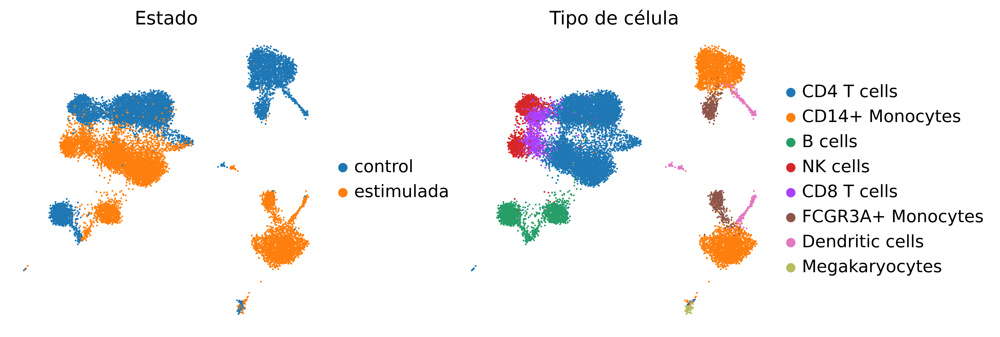

In [41]:
sc.pl.umap(
    adata,
    color=["Estado", "Tipo de célula"],
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(figs_path.joinpath("ivae_scorer_reactome.pdf"), bbox_inches="tight")
plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome.png"), bbox_inches="tight", dpi=300
)

In [42]:
sc.pl.umap(
    adata,
    color=dacs_to_write.pathways.tolist(),
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(figs_path.joinpath("ivae_scorer_reactome_top10.pdf"), bbox_inches="tight")
plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome_top10.png"), bbox_inches="tight", dpi=300
)